In [1]:
import pandas
import numpy as np
from utils import *
import mne
import matplotlib.pyplot as plt
from os import walk
from sklearn.decomposition import FastICA
from sklearn.naive_bayes import GaussianNB, MultinomialNB
from sklearn.model_selection import cross_val_score
from itertools import combinations
from sklearn.preprocessing import normalize
from tqdm.notebook import tqdm
import pickle

from multiprocessing import Pool
plt.style.use('seaborn-whitegrid')

# Groud truth - Median

In [4]:
df = pandas.read_csv('./HEXACO.csv')
# Honesty-Humility	Emotionality	eXtraversion	Agreeableness	Conscientiousness	Openness to Experience
gt = df[['id','Honesty-Humility','Emotionality','eXtraversion','Agreeableness','Conscientiousness','Openness to Experience']].rename(columns={'Honesty-Humility':'h',
                                  'Emotionality':'e',
                                  'eXtraversion':'x',
                                 'Agreeableness':'a',
                             'Conscientiousness':'c',
                        'Openness to Experience':'o'}).set_index('id')

gt['lh'] = (gt[['h']] > np.median(gt['h'])) * 1
gt['le'] = (gt[['e']] > np.median(gt['e'])) * 1
gt['lx'] = (gt[['x']] > np.median(gt['x'])) * 1
gt['la'] = (gt[['a']] > np.median(gt['a'])) * 1
gt['lc'] = (gt[['c']] > np.median(gt['c'])) * 1
gt['lo'] = (gt[['o']] > np.median(gt['o'])) * 1
gt

,h,e,x,a,c,o,lh,le,lx,la,lc,lo
id,,,,,,,,,,,,
2,3.63,3.19,2.94,2.38,3.38,2.38,1,0,0,0,0,0
3,3.38,3.44,3.50,3.50,4.50,3.81,0,0,1,1,1,1
4,3.19,3.75,3.69,3.19,2.63,2.63,0,1,1,0,0,0
5,3.25,3.63,2.13,3.56,3.63,2.31,0,1,0,1,1,0
6,3.25,2.75,3.50,2.50,3.75,5.00,0,0,1,0,1,1
7,4.06,3.06,3.38,2.88,2.50,4.19,1,0,1,0,0,1
8,3.94,2.94,3.19,3.75,3.38,3.81,1,0,1,1,0,1
9,4.44,4.00,3.38,3.75,3.69,3.31,1,1,1,1,1,0
10,3.63,3.25,3.50,3.31,3.88,2.69,1,0,1,1,1,0


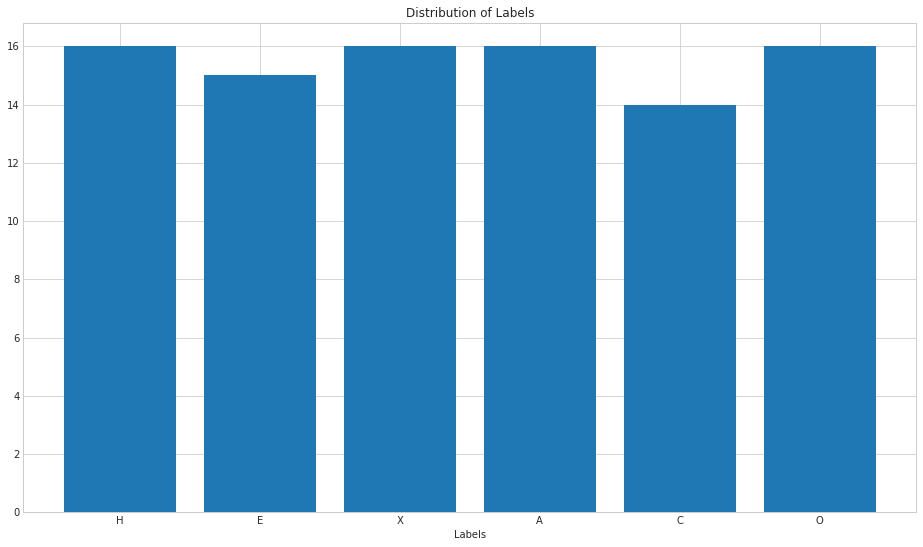

In [5]:
fig, ax = plt.subplots(figsize=(16,9))
ax.bar(['H','E','X','A','C','O'],[ sum(gt['lh']), sum(gt['le']), sum(gt['lx']), sum(gt['la']), sum(gt['lc']), sum(gt['lo'])  ])
ax.set_title("Distribution of Labels")
ax.set_xlabel("Labels")
# ax.set_ylabel("Distribution of Labels")
plt.show()

# EEG data

In [2]:
def load_data():
    path, folders, filenames = next(walk('./data'))

    filenames.remove('11-audio.csv')
    filenames.remove('11-image.csv')

    filenames.remove('36-audio.csv')
    filenames.remove('36-image.csv')

    path = './data'
    columns = {'Unnamed: 1':'Fp1',
            'Unnamed: 2':'Fp2',
            'Unnamed: 3':'F3',
            'Unnamed: 4':'F4',
            'Unnamed: 5':'F7',
            'Unnamed: 6':'F8',
            'Unnamed: 7':'P7',
            'Unnamed: 8':'P8'}

    EEG_audio, EEG_image = dict(), dict()
    from itertools import product
    categories = [1,2,3,4,5]
    blocks = [1,2]
    with tqdm(filenames) as t:
        for filename in t:
            t.set_description(f"{filename}")
            participant_id, stimuli = filename.split('-')
            stimuli = stimuli.rstrip('.csv')
            data = pandas.read_csv(f'{path}/{filename}', dtype={'Marker': str}).rename(columns=columns).drop(columns='timestamps')
            # Aviod warning on stim has negative value
            marker = np.array(data['Marker'])
            marker[marker == '-1'] = '1'
            data['Marker'] = marker

            if(stimuli == 'audio'):
                EEG_audio[int(participant_id)] = data
            elif(stimuli == 'image'):
                EEG_image[int(participant_id)] = data
            else:
                raise ValueError(f"Stimuli:{stimuli} is unexpected.")
    return EEG_audio, EEG_image


In [3]:
# clear_cache()
try:
    # Load from cache
    EEG_audio = load('EEG_audio')
    EEG_image = load('EEG_image')
    print('Load data from cache')
    if( set(EEG_audio.keys()) != set(EEG_image.keys()) ):
        extra = None
        if(len(EEG_audio.keys()) > len(EEG_image.keys())):
            extra = set(EEG_audio.keys()).difference( set(EEG_image.keys()) )
        else:
            extra = set(EEG_image.keys()).difference( set(EEG_audio.keys()) )
        raise ValueError(f"In equal keys. audio has {len(EEG_audio.keys())} and image has {len(EEG_image.keys())}. The extra key is {extra}")

except FileNotFoundError as e:
    EEG_audio, EEG_image = load_data()
    # Save to cache
    save(EEG_audio, 'EEG_audio')
    save(EEG_image, 'EEG_image')

Load data from cache


# Pre process with PSD + log + mne ICA

In [6]:
# filter_list = [[0,4],[4,8],[8,13],[13,30],[30,125]]
raw = dataframe_to_raw(EEG_audio[33], sfreq=250)
            
# # Preprocess
raw.notch_filter([50,100],filter_length='auto', phase='zero', verbose=False) # Line power
raw.filter(1., None, verbose=False) # Slow drift
# ica = mne.preprocessing.ICA(n_components=8, max_iter='auto')
# ica.fit(raw, verbose=False)
# raw = ica.apply(raw, verbose=False)

events = mne.find_events(raw, stim_channel='Marker', initial_event=True, verbose=False, uint_cast=False)
events = np.delete(events,np.argwhere(events[:,2] == 1), axis=0) # break
# # Check data
# if(events.shape[0] != 50):
#     raise ValueError(f"Event missing: {events[:,2]}. len(events.shape[0])={events.shape[0]}")
epochs = mne.Epochs(raw, events, tmin=0.3, tmax=5.8, baseline=(0.3,0.3), verbose=False)
# if(epochs.get_data().shape[0] != 50):
#     raise ValueError(f"There might be a bad data. epochs.get_data().shape = {epochs.get_data().shape}")

# # Extract features

# for evoked in epochs.iter_evoked():
#     power,freq = mne.time_frequency.psd_array_welch(evoked.data,sfreq=250,n_fft=128, verbose=False)
#     break
times = np.arange(0.3,5.8,0.5)

## TOPO image

111


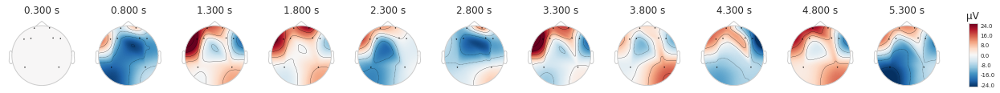

112


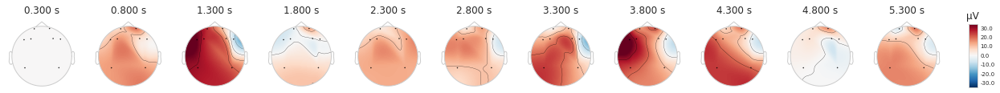

113


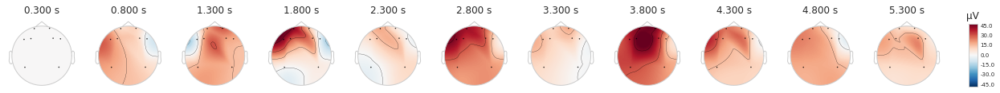

114


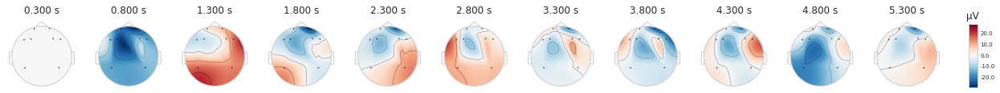

115


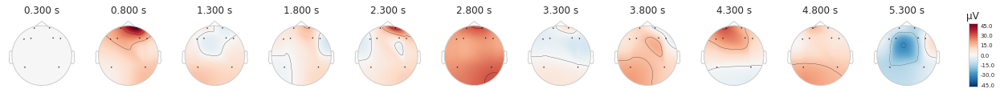

121


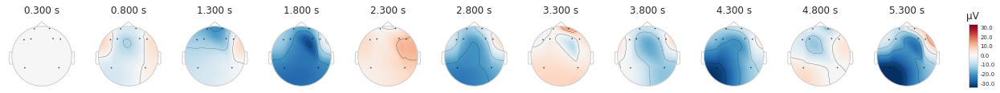

122


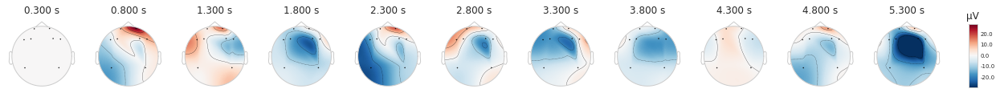

123


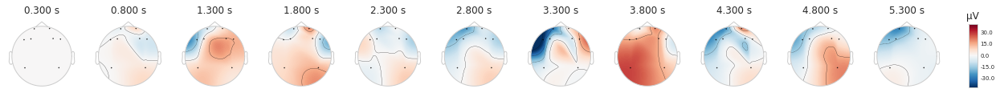

124


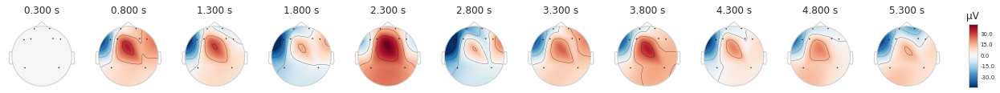

125


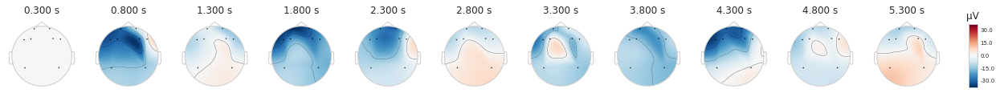

221


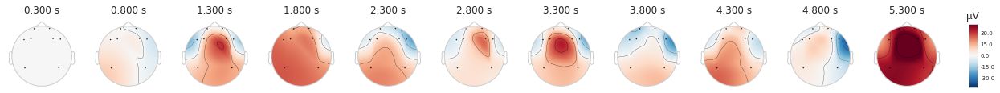

222


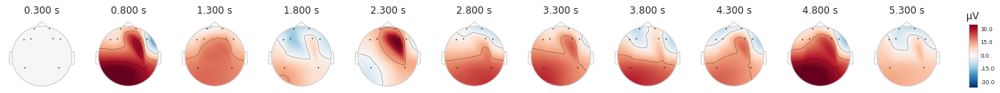

223


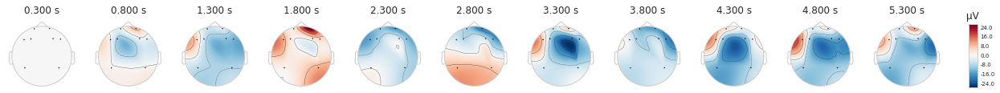

224


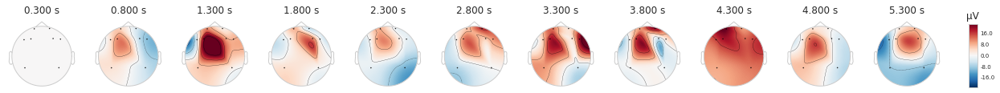

225


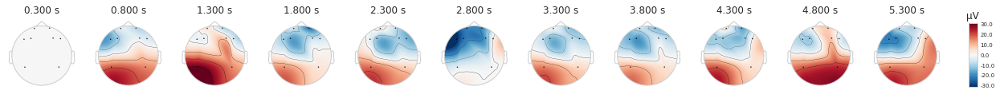

211


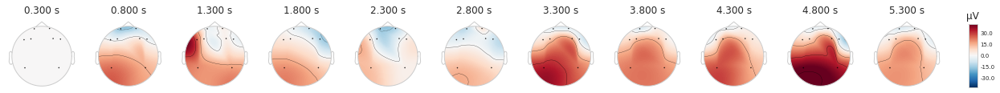

212


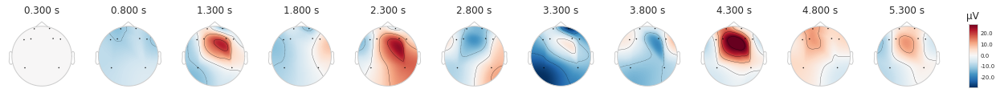

213


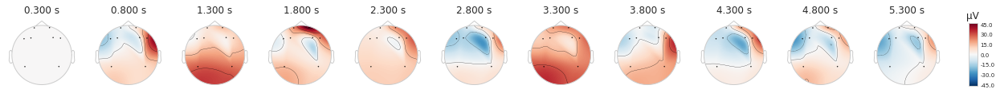

214


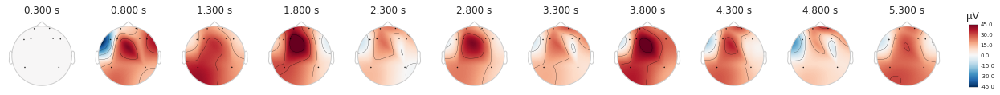

215


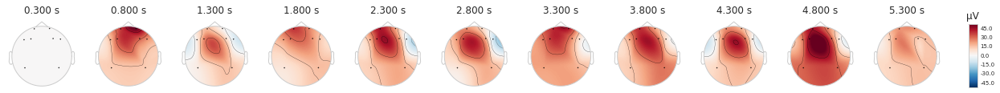

In [13]:
# # Extract features
print_list = [1,2]
for l in print_list:
    for evoked in epochs.iter_evoked():
        if(evoked.comment[0] != str(l)): continue
        print(evoked.comment)
        evoked.plot_topomap(times)
    # power,freq = mne.time_frequency.psd_array_welch(evoked.data,sfreq=250,n_fft=128, verbose=False)
    # break

321


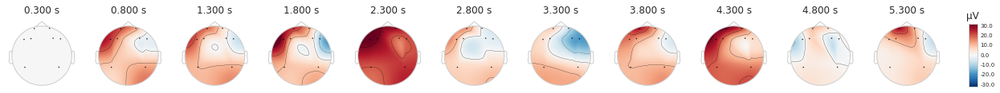

322


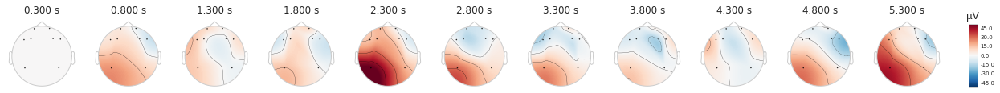

323


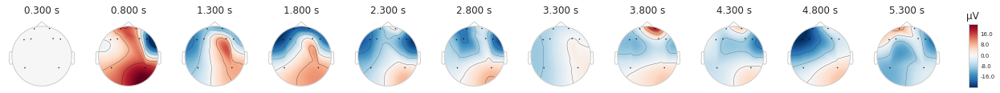

324


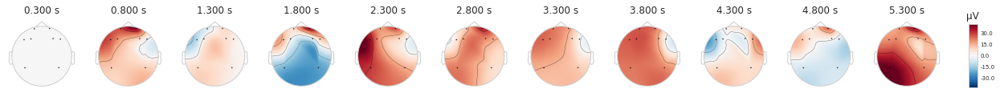

325


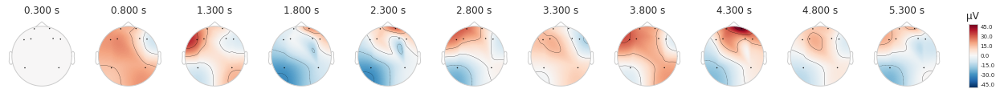

311


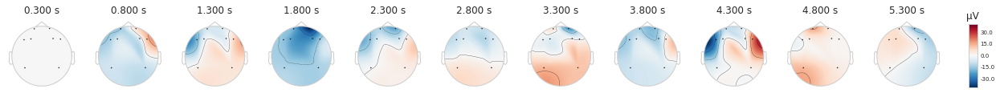

312


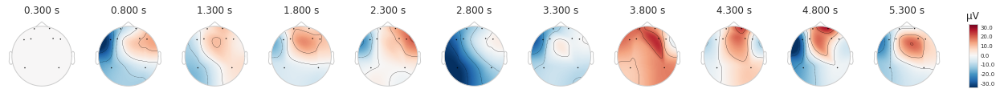

313


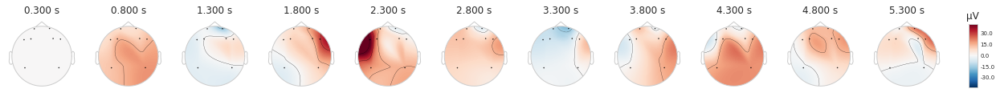

314


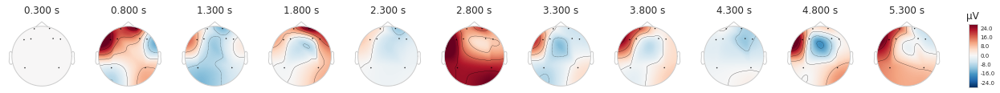

315


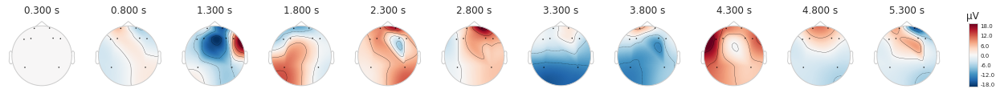

421


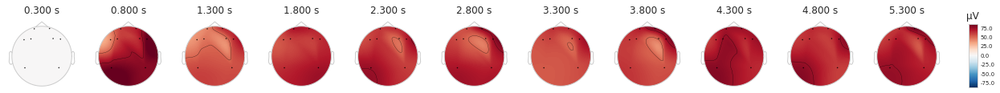

422


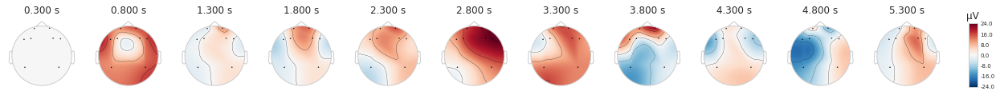

423


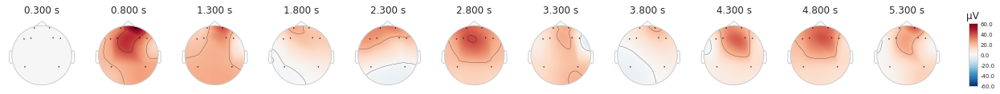

424


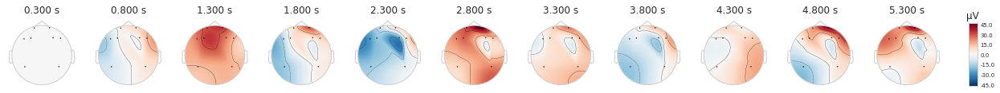

425


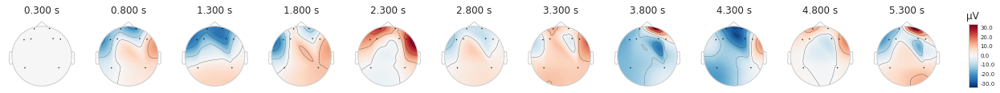

411


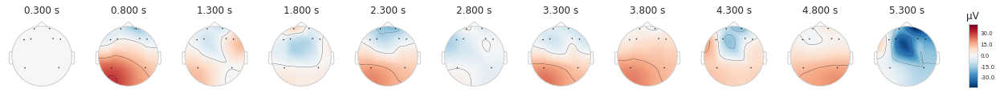

412


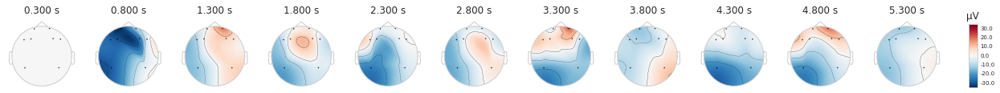

413


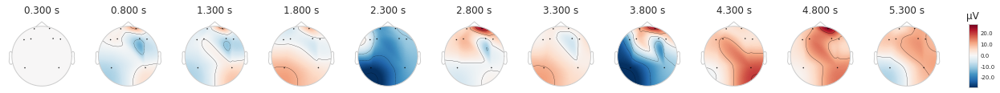

414


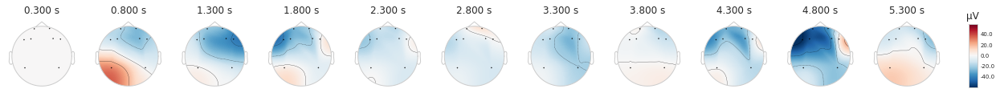

415


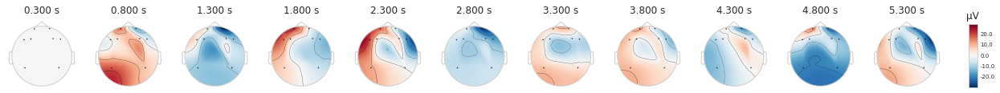

In [14]:
# # Extract features
print_list = [3,4]
for l in print_list:
    for evoked in epochs.iter_evoked():
        if(evoked.comment[0] != str(l)): continue
        print(evoked.comment)
        evoked.plot_topomap(times)
    # power,freq = mne.time_frequency.psd_array_welch(evoked.data,sfreq=250,n_fft=128, verbose=False)
    # break

511


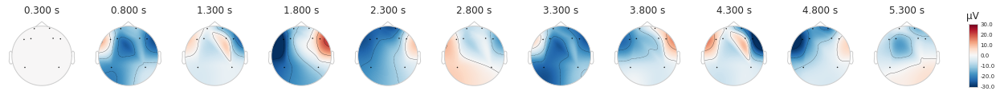

512


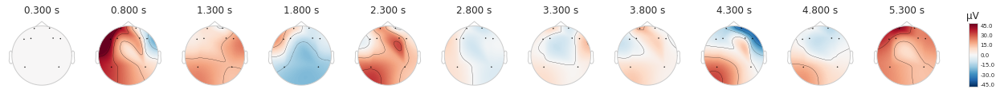

513


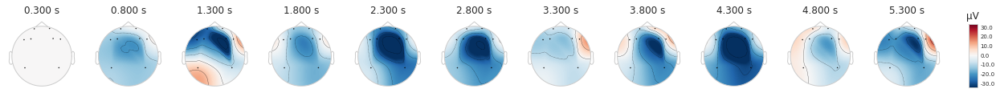

514


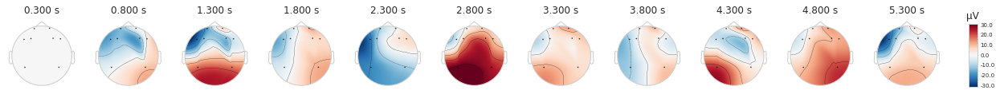

515


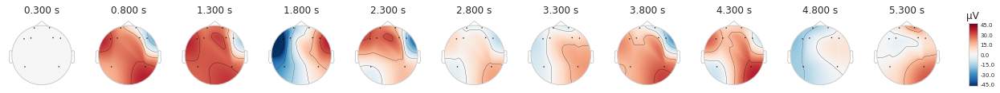

521


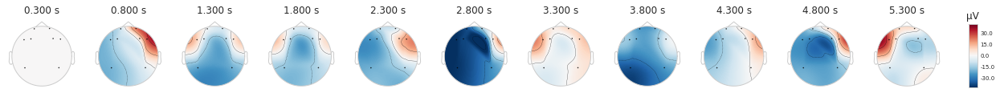

522


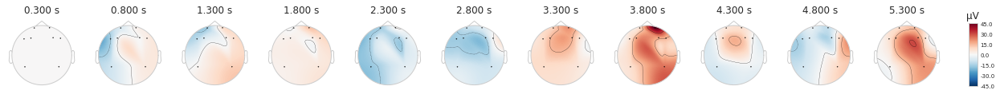

523


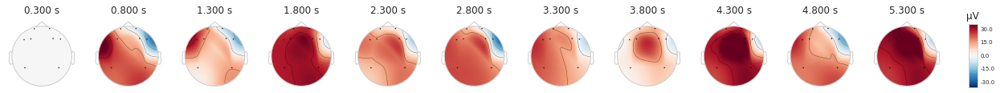

524


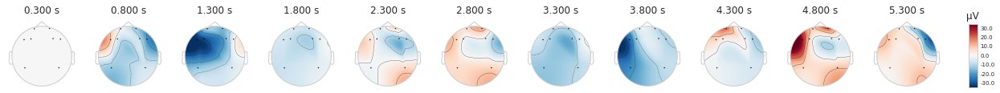

525


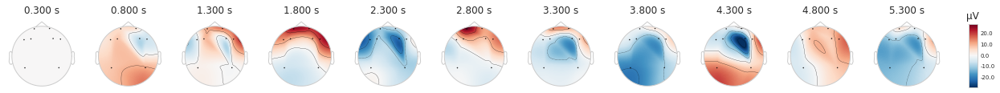

In [15]:
# # Extract features
print_list = [5]
for l in print_list:
    for evoked in epochs.iter_evoked():
        if(evoked.comment[0] != str(l)): continue
        print(evoked.comment)
        evoked.plot_topomap(times)
    # power,freq = mne.time_frequency.psd_array_welch(evoked.data,sfreq=250,n_fft=128, verbose=False)
    # break

## TOPO audio

111


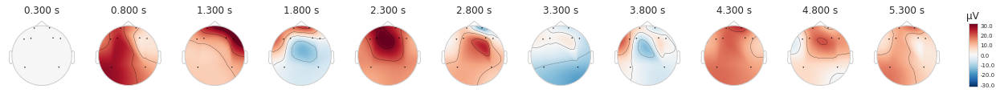

112


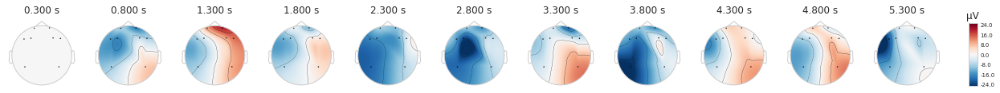

113


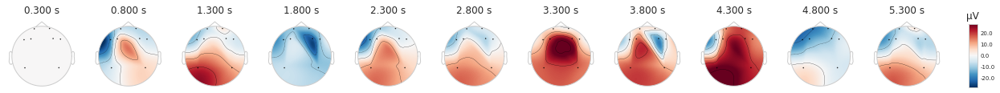

114


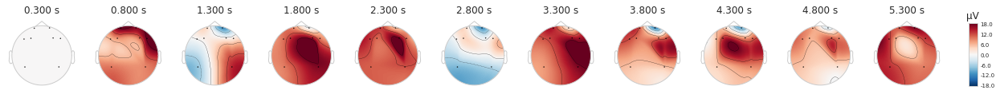

115


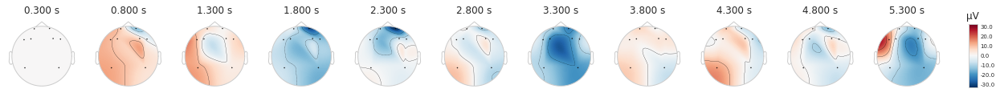

121


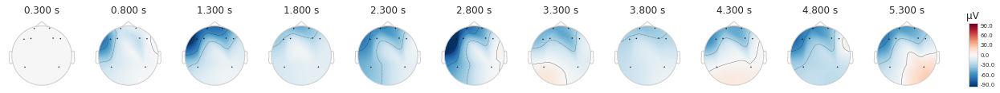

122


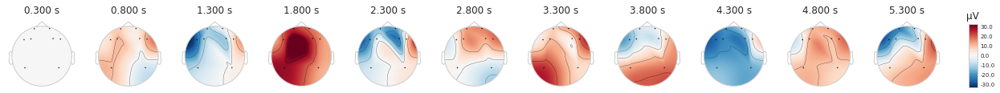

123


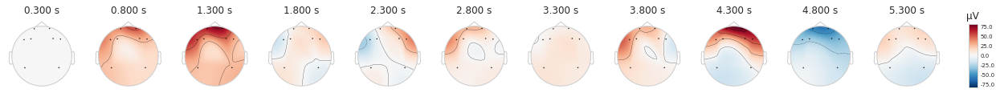

124


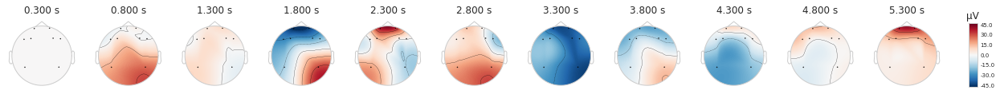

125


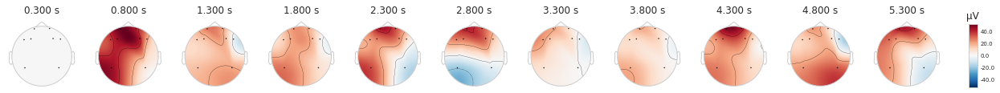

221


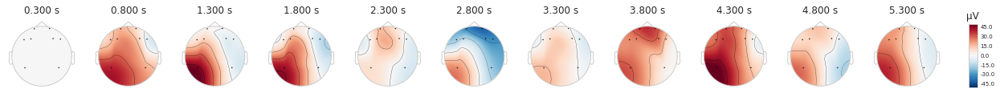

222


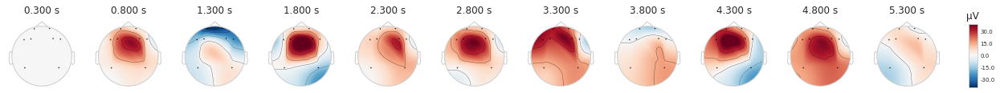

223


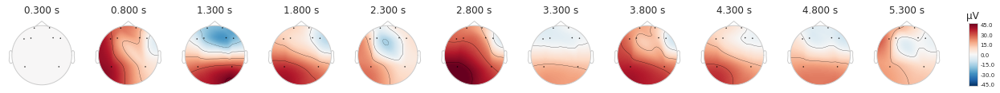

224


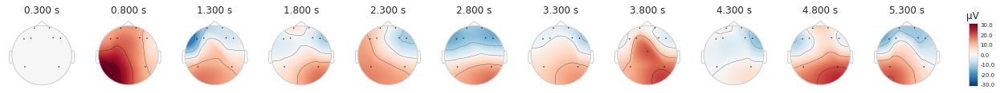

225


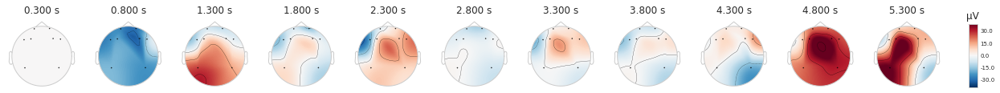

211


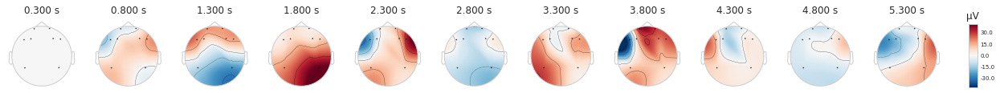

212


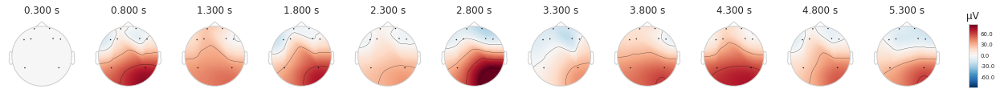

213


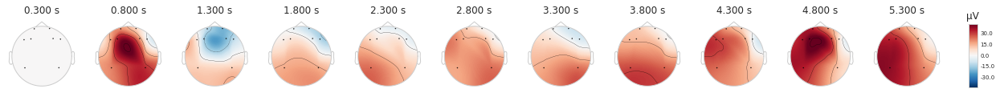

214


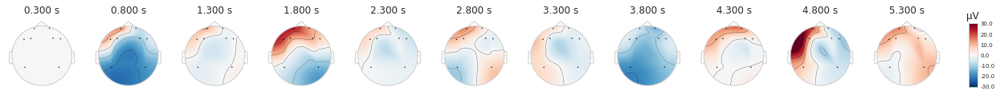

215


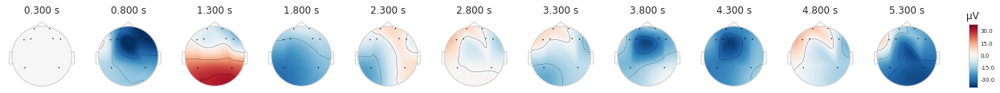

In [17]:
# # Extract features
print_list = [1,2]
for l in print_list:
    for evoked in epochs.iter_evoked():
        if(evoked.comment[0] != str(l)): continue
        print(evoked.comment)
        evoked.plot_topomap(times)
    # power,freq = mne.time_frequency.psd_array_welch(evoked.data,sfreq=250,n_fft=128, verbose=False)
    # break

321


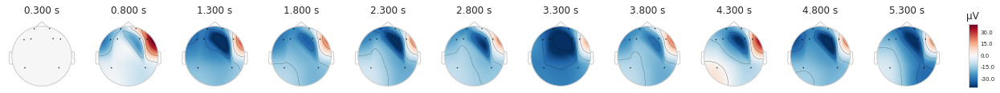

322


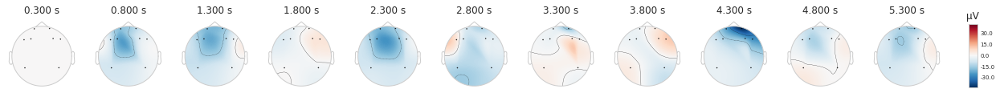

323


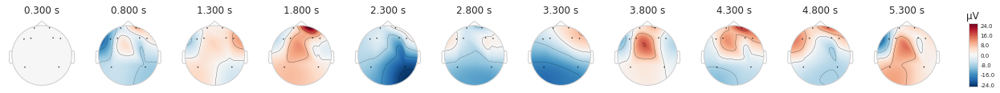

324


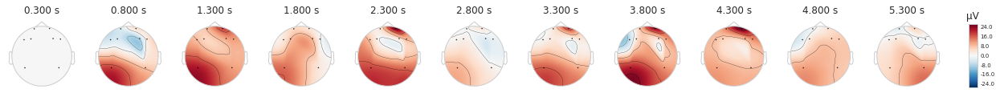

325


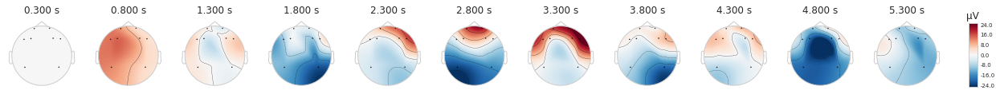

311


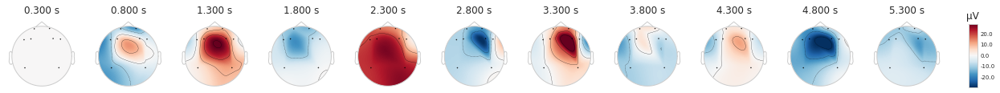

312


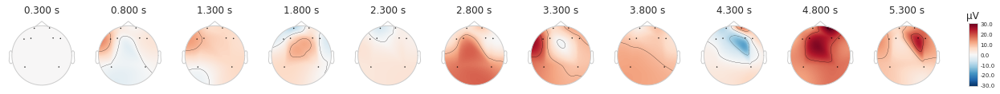

313


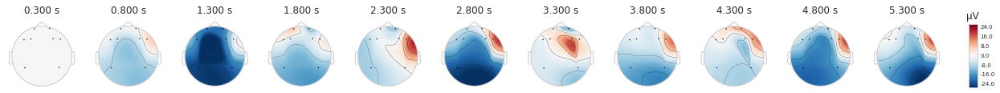

314


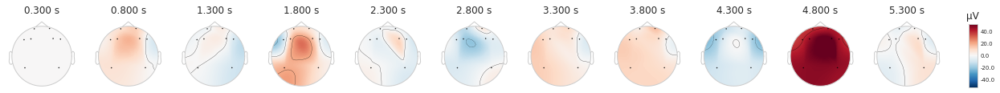

315


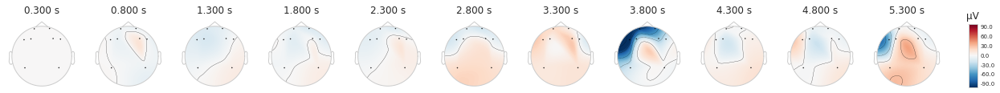

421


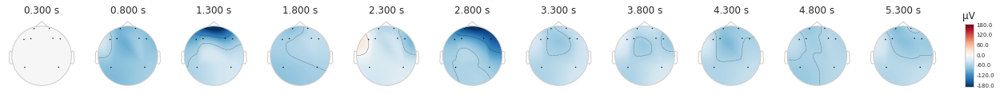

422


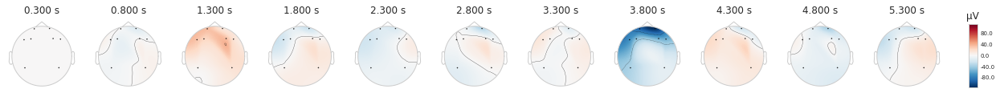

423


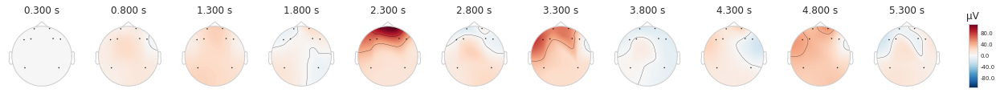

424


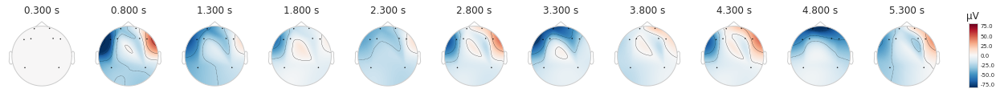

425


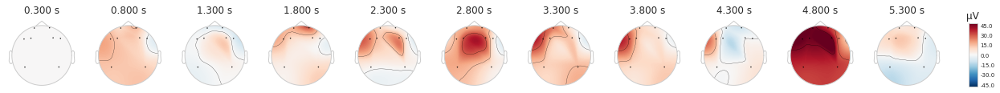

411


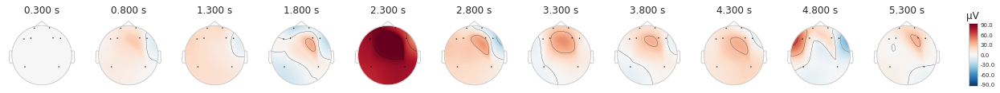

412


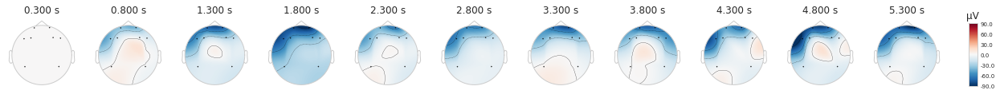

413


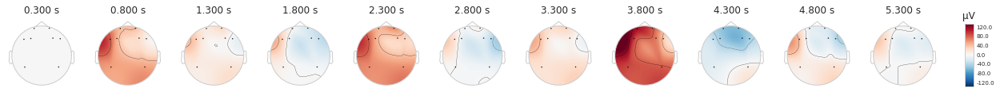

414


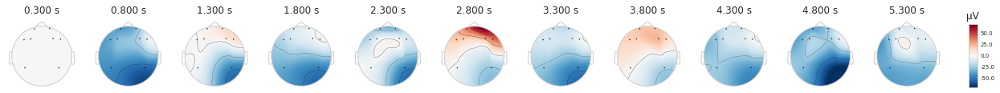

415


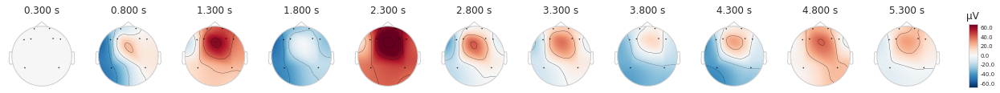

In [7]:
# # Extract features
print_list = [3,4]
for l in print_list:
    for evoked in epochs.iter_evoked():
        if(evoked.comment[0] != str(l)): continue
        print(evoked.comment)
        evoked.plot_topomap(times)
    # power,freq = mne.time_frequency.psd_array_welch(evoked.data,sfreq=250,n_fft=128, verbose=False)
    # break

511


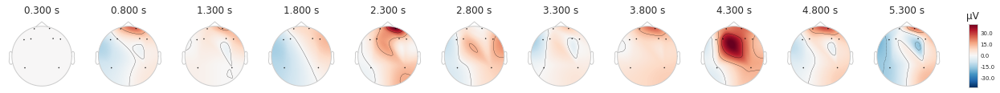

512


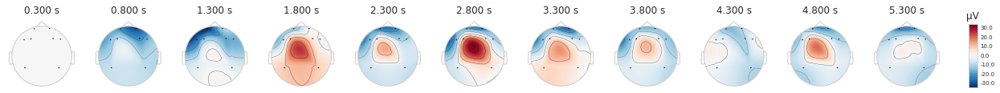

513


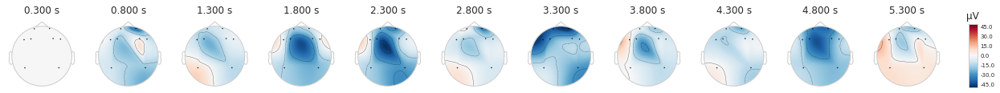

514


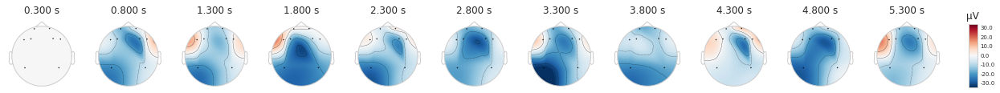

515


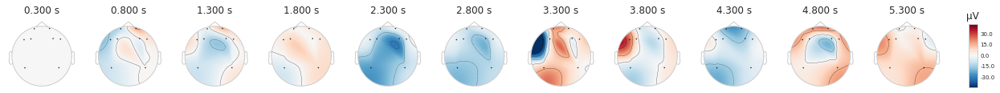

521


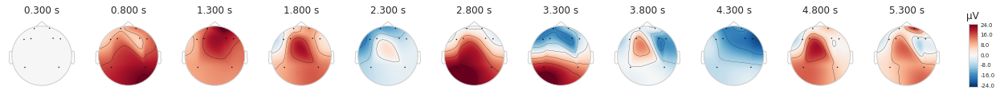

522


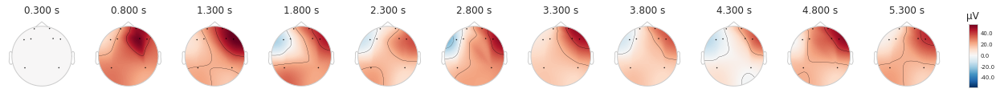

523


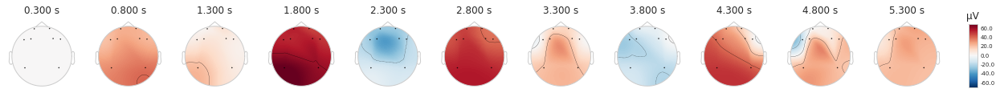

524


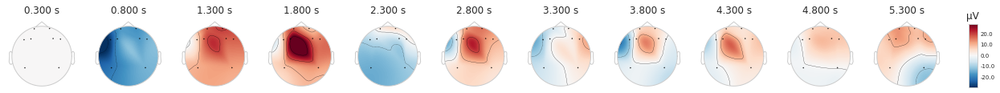

525


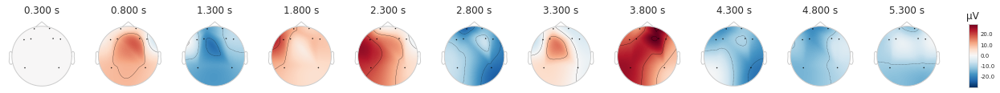

In [8]:
# # Extract features
print_list = [5]
for l in print_list:
    for evoked in epochs.iter_evoked():
        if(evoked.comment[0] != str(l)): continue
        print(evoked.comment)
        evoked.plot_topomap(times)
    # power,freq = mne.time_frequency.psd_array_welch(evoked.data,sfreq=250,n_fft=128, verbose=False)
    # break

In [ ]:
# filt = filter_list[0]
# print(power.shape, freq)

In [8]:
# features = []
# for filt in filter_list:
#     a = np.argwhere((freq <= filt[1]) & (freq >= filt[0])).reshape(-1)
#     # print(a.reshape(-1))
#     features.append(list(power[:,a].mean(axis=0)))
#     # break
# np.array(features)

In [9]:
band_names = np.array(['Delta', 'Theta', 'Alpha', 'Beta', 'Gamma'])
filter_list = [[0,4],[4,8],[8,13],[13,30],[30,125]]
def build_data(p_num, EEG,ids):
    X = None
    Y = None
    with tqdm(ids) as t:
        for index, id in enumerate(t):
            t.set_description(f"{id}")
            print(f"p_no={p_num}|index={index}|id={id}")
            raw = dataframe_to_raw(EEG[id], sfreq=250)
            
            # Preprocess
            raw.notch_filter([50,100],filter_length='auto', phase='zero', verbose=False) # Line power
            raw.filter(1., None, verbose=False) # Slow drift
            ica = mne.preprocessing.ICA(n_components=8, max_iter='auto')
            ica.fit(raw, verbose=False)
            raw = ica.apply(raw, verbose=False)

            events = mne.find_events(raw, stim_channel='Marker', initial_event=True, verbose=False, uint_cast=False)
            events = np.delete(events,np.argwhere(events[:,2] == 1), axis=0) # break
            # Check data
            if(events.shape[0] != 50):
                raise ValueError(f"Event missing: {events[:,2]}. len(events.shape[0])={events.shape[0]}")
            epochs = mne.Epochs(raw, events, tmin=0.3, tmax=5.8, baseline=(0.3,0.3), verbose=False)
            if(epochs.get_data().shape[0] != 50):
                raise ValueError(f"There might be a bad data. epochs.get_data().shape = {epochs.get_data().shape}")

            # Extract features

            for evoked in epochs.iter_evoked():
                power,freq = mne.time_frequency.psd_array_welch(evoked.data,sfreq=250,n_fft=128, verbose=False)
                # print(power.shape, power[:8].shape)
                # row = power[:8].mean(axis=0)
                # row = np.expand_dims(row.reshape(-1), axis=0)
                row = power[:8]
                row = np.expand_dims(row, axis=0)
                row = 10 * np.log10(row)
                if(type(X) == type(None)): X = row
                else: X = np.concatenate( [X, row ], axis=0 )

                label = gt.loc[id][['lh','le','lx','la','lc','lo']].to_numpy()
                label = np.expand_dims(label, axis=0)
                if(type(Y) == type(None)): Y = label
                else: Y = np.concatenate( [Y, label ], axis=0 )

    print(f"{p_num} done| {ids}")
    return np.array(X),np.array(Y),freq

def get_accuracy(X,y):
    result = []
    traits = ["h","e","x","a","c","o"]
    for index,label in enumerate(traits):
        y = Y[:,index]
        X_copy = X.copy() * -1
        mnb = MultinomialNB()
        mnb.fit(X_copy, y)
        acc = sum(mnb.predict(X_copy) == y) / len(y)
        scores = cross_val_score(mnb, X_copy, y)
        result.append([acc,scores.mean(),scores.std()])
        print(label,"| Accuracy: %0.2f Scores: %0.2f (+/- %0.2f)" % (acc,scores.mean(), scores.std() * 2))
    return result

In [10]:
try:
    # [33,2,10,12,16]
    t_out = 300
    pool = Pool()
    ids = np.array(list(EEG_image.keys()))
    p1 = pool.apply_async(build_data, [1,EEG_image,ids[0::6]])
    p2 = pool.apply_async(build_data, [2,EEG_image,ids[1::6]])
    p3 = pool.apply_async(build_data, [3,EEG_image,ids[2::6]])
    p4 = pool.apply_async(build_data, [4,EEG_image,ids[3::6]])
    p5 = pool.apply_async(build_data, [5,EEG_image,ids[4::6]])
    p6 = pool.apply_async(build_data, [6,EEG_image,ids[5::6]])
    ans1 = p1.get(timeout=t_out)
    ans2 = p2.get(timeout=t_out)
    ans3 = p3.get(timeout=t_out)
    ans4 = p4.get(timeout=t_out)
    ans5 = p5.get(timeout=t_out)
    ans6 = p6.get(timeout=t_out)
    X = np.concatenate([ans1[0] , ans2[0], ans3[0], ans4[0] ,ans5[0], ans6[0]])
    Y = np.concatenate([ans1[1] , ans2[1], ans3[1], ans4[1] ,ans5[1], ans6[1]])
    freq = ans1[2]
    print(X.shape, Y.shape)
finally:
    print("========= close ========")
    pool.close() 
    pool.terminate()

p_no=1|index=0|id=10
p_no=2|index=0|id=12
p_no=3|index=0|id=13
p_no=4|index=0|id=14
p_no=5|index=0|id=15
p_no=6|index=0|id=16
p_no=1|index=1|id=17
p_no=4|index=1|id=20
p_no=2|index=1|id=18
p_no=3|index=1|id=2
p_no=5|index=1|id=21
p_no=6|index=1|id=22
p_no=4|index=2|id=27
p_no=3|index=2|id=26
p_no=2|index=2|id=25
p_no=1|index=2|id=23
p_no=5|index=2|id=28
p_no=6|index=2|id=29
p_no=4|index=3|id=32
p_no=2|index=3|id=30
p_no=3|index=3|id=31
p_no=1|index=3|id=3
p_no=5|index=3|id=33
p_no=6|index=3|id=34
p_no=4|index=4|id=7
p_no=3|index=4|id=6
p_no=1|index=4|id=35
p_no=5|index=4|id=8
<ipython-input-9-6b3575a2bf52>:16: RuntimeWarning: Using n_components=8 (resulting in n_components_=8) may lead to an unstable mixing matrix estimation because the ratio between the largest (8) and smallest (2.4e-06) variances is too large (> 1e6); consider setting n_components=0.999999 or an integer <= 5
  ica.fit(raw, verbose=False)
p_no=2|index=4|id=5
p_no=6|index=4|id=9
4 done| [14 20 27 32  7]
3 done| [13  2 

In [11]:
bands = []
for filt in filter_list:
    pt = np.argwhere((freq >= filt[0]) & (freq <= filt[1])).reshape(-1)
    bands.append(pt)
bands = np.array(bands)

result_image = []
best_image = 0
best_image_idx = -1
best_image_comb = None
for r in [1,2,3,4,5]:
    print("="*20,f"Number {r}","="*20)
    for comb in combinations([0,1,2,3,4],r):
        print(" ",band_names[list(comb)])
        selected_x = None
        # print(bands[ list(comb) ])
        for pt in bands[ list(comb) ]:
            # print(pt)
            if(type(selected_x) == type(None)): selected_x = X[:,:,pt].mean(axis=2)
            else:
                selected_x = np.concatenate([selected_x, X[:,:,pt].mean(axis=2)], axis=1)
        # print(selected_x.shape)
        # pts = np.concatenate( bands[ list(comb) ] )
        result = np.array(get_accuracy(selected_x,Y))
        print(" Averag accuracy:", result[:,0].mean(), "Average Score:", result[:,1].mean(), "Average Variance:", result[:,2].mean())
        result_image.append(result)
        if(result[:,1].mean() > best_image):
            best_image = result[:,1].mean()
            best_image_idx = len(result_image)-1
            best_image_comb = band_names[ list(comb) ]

print(f"Best Score is {best_image} at index {best_image_idx} with combination {best_image_comb}")

==================== Number 1 ====================
  ['Delta']
h | Accuracy: 0.53 Scores: 0.50 (+/- 0.11)
e | Accuracy: 0.60 Scores: 0.60 (+/- 0.00)
x | Accuracy: 0.53 Scores: 0.53 (+/- 0.01)
a | Accuracy: 0.57 Scores: 0.54 (+/- 0.06)
c | Accuracy: 0.59 Scores: 0.58 (+/- 0.02)
o | Accuracy: 0.53 Scores: 0.36 (+/- 0.14)
 Averag accuracy: 0.5601111111111111 Average Score: 0.5176666666666666 Average Variance: 0.027651951421836806
  ['Theta']
h | Accuracy: 0.55 Scores: 0.53 (+/- 0.14)
e | Accuracy: 0.60 Scores: 0.60 (+/- 0.00)
x | Accuracy: 0.53 Scores: 0.53 (+/- 0.00)
<ipython-input-11-7430389412e5>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  bands = np.array(bands)
a | Accuracy: 0.58 Scores: 0.54 (+/- 0.04)
c | Accuracy: 0.57 Scores: 0.57 (+/- 0.00)
o | Accuracy: 0.

In [12]:
try:
    # [33,2,10,12,16]
    t_out = 300
    pool = Pool()
    ids = np.array(list(EEG_image.keys()))
    p1 = pool.apply_async(build_data, [1,EEG_audio,ids[0::6]])
    p2 = pool.apply_async(build_data, [2,EEG_audio,ids[1::6]])
    p3 = pool.apply_async(build_data, [3,EEG_audio,ids[2::6]])
    p4 = pool.apply_async(build_data, [4,EEG_audio,ids[3::6]])
    p5 = pool.apply_async(build_data, [5,EEG_audio,ids[4::6]])
    p6 = pool.apply_async(build_data, [6,EEG_audio,ids[5::6]])
    ans1 = p1.get(timeout=t_out)
    ans2 = p2.get(timeout=t_out)
    ans3 = p3.get(timeout=t_out)
    ans4 = p4.get(timeout=t_out)
    ans5 = p5.get(timeout=t_out)
    ans6 = p6.get(timeout=t_out)
    X = np.concatenate([ans1[0] , ans2[0], ans3[0], ans4[0] ,ans5[0], ans6[0]])
    Y = np.concatenate([ans1[1] , ans2[1], ans3[1], ans4[1] ,ans5[1], ans6[1]])
    print(X.shape, Y.shape)
finally:
    print("========= close ========")
    pool.close() 
    pool.terminate()

p_no=1|index=0|id=10
p_no=2|index=0|id=12
p_no=3|index=0|id=13
p_no=4|index=0|id=14
p_no=5|index=0|id=15
p_no=6|index=0|id=16
p_no=4|index=1|id=20
p_no=1|index=1|id=17
p_no=3|index=1|id=2
p_no=2|index=1|id=18
p_no=6|index=1|id=22
p_no=5|index=1|id=21
p_no=4|index=2|id=27
p_no=1|index=2|id=23
p_no=3|index=2|id=26
p_no=2|index=2|id=25
p_no=6|index=2|id=29
p_no=5|index=2|id=28
p_no=4|index=3|id=32
p_no=1|index=3|id=3
p_no=3|index=3|id=31
p_no=2|index=3|id=30
p_no=6|index=3|id=34
p_no=5|index=3|id=33
p_no=4|index=4|id=7
p_no=1|index=4|id=35
p_no=3|index=4|id=6
p_no=2|index=4|id=5
p_no=6|index=4|id=9
p_no=5|index=4|id=8
4 done| [14 20 27 32  7]
1 done| [10 17 23  3 35]
3 done| [13  2 26 31  6]
6 done| [16 22 29 34  9]
5 done| [15 21 28 33  8]
2 done| [12 18 25 30  5]
(1500, 8, 65) (1500, 6)
========= close ========


In [13]:
bands = []
for filt in filter_list:
    pt = np.argwhere((freq >= filt[0]) & (freq <= filt[1])).reshape(-1)
    bands.append(pt)
bands = np.array(bands)

result_audio = []
best_audio = 0
best_audio_idx = -1
best_audio_comb = None
for r in [1,2,3,4,5]:
    print("="*20,f"Number {r}","="*20)
    for comb in combinations([0,1,2,3,4],r):
        print(" ",band_names[list(comb)])
        selected_x = None
        # print(bands[ list(comb) ])
        for pt in bands[ list(comb) ]:
            # print(pt)
            if(type(selected_x) == type(None)): selected_x = X[:,:,pt].mean(axis=2)
            else:
                selected_x = np.concatenate([selected_x, X[:,:,pt].mean(axis=2)], axis=1)
        # print(selected_x.shape)
        # pts = np.concatenate( bands[ list(comb) ] )
        result = np.array(get_accuracy(selected_x,Y))
        print(" Averag accuracy:", result[:,0].mean(), "Average Score:", result[:,1].mean()), "Average Variance:", result[:,2].mean()
        result_audio.append(result)
        if(result[:,1].mean() > best_audio):
            best_audio = result[:,1].mean()
            best_audio_idx = len(result_audio)-1
            best_audio_comb = band_names[ list(comb) ]

print(f"Best Score is {best_audio} at index {best_audio_idx} with combination {best_audio_comb}")

==================== Number 1 ====================
  ['Delta']
h | Accuracy: 0.59 Scores: 0.48 (+/- 0.15)
e | Accuracy: 0.60 Scores: 0.60 (+/- 0.00)
x | Accuracy: 0.54 Scores: 0.54 (+/- 0.02)
a | Accuracy: 0.56 Scores: 0.42 (+/- 0.25)
c | Accuracy: 0.57 Scores: 0.57 (+/- 0.00)
o | Accuracy: 0.60 Scores: 0.58 (+/- 0.18)
 Averag accuracy: 0.5772222222222222 Average Score: 0.5298888888888889
  ['Theta']
h | Accuracy: 0.55 Scores: 0.43 (+/- 0.12)
e | Accuracy: 0.60 Scores: 0.60 (+/- 0.00)
x | Accuracy: 0.53 Scores: 0.53 (+/- 0.00)
a | Accuracy: 0.60 Scores: 0.38 (+/- 0.21)
c | Accuracy: 0.57 Scores: 0.57 (+/- 0.00)
o | Accuracy: 0.58 Scores: 0.54 (+/- 0.11)
 Averag accuracy: 0.5728888888888889 Average Score: 0.5086666666666667
  ['Alpha']
<ipython-input-13-763060cf1875>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must spec

In [14]:
result_image = np.array(result_image)
result_audio = np.array(result_audio)


In [15]:
result_audio.shape

(31, 6, 3)

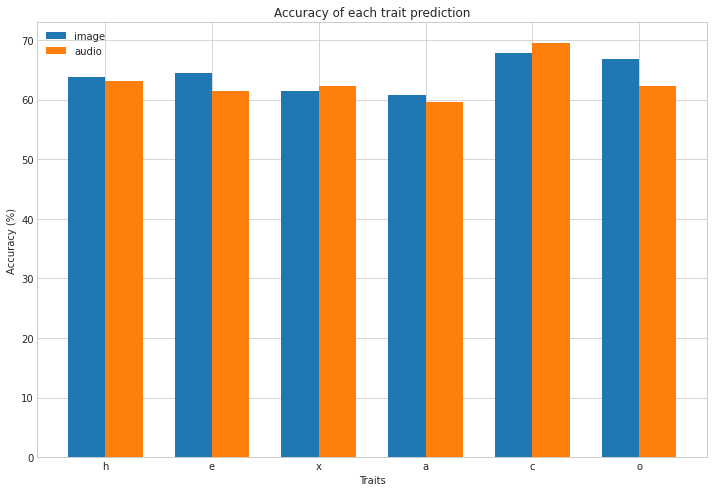

In [16]:
traits = ["h","e","x","a","c","o"]
width =.35

fig, ax = plt.subplots(figsize=(12,8))

ax.bar(np.arange(6)      ,result_image[30,:,0] * 100, width=width, label='image', ecolor='black', capsize=10)
ax.bar(np.arange(6)+width,result_audio[30,:,0] * 100, width=width, label='audio', ecolor='black', capsize=10)

ax.set_xlabel('Traits')
ax.set_ylabel('Accuracy (%)')
ax.set_title('Accuracy of each trait prediction')
ax.set_xticks(np.arange(6) + width / 2)
ax.set_xticklabels(traits)
ax.legend()

plt.show()

In [17]:
# print(f"On average, image accuracy is {round(result_image[:,0].mean(),2)} and audio accuracy is {round(result_audio[:,0].mean(),2)}")
# print(f"On average, image    score is {round(result_image[:,1].mean(),2)} and audio    score is {round(result_audio[:,1].mean(),2)}")
# print(f"On average, image      std is {round(result_image[:,2].mean(),2)} and audio      std is {round(result_audio[:,2].mean(),2)}")